# Step 11: Cavity Flow with Navier-Stokes

Here we are, finally solving the Navier-stokes equations in two dimensions. The last two steps of the module will be focusing on solving these equations but with different boundary conditions. 

We begin with the momentum equation in vector form for a velocity field $\vec{v}$ :

$$ \frac{\partial \vec{v}}{\partial t} + (\vec{v} \cdot \nabla) \vec{v} = - \frac{1}{\rho} \nabla p + \nu \nabla^2 \vec{v} $$

This can also be understoon as a set of scalar equations, one for each velocity component $(u,v,w)$. But we will solve it in two dimensions, so there will only be two scalar equations.

Now, if you were missing the continuity equation, do not worry! This is where our work on the previous step related to the Poisson equation comes into play.

Here is the system of differential equations: two equations for the velocity component and one for pressure:

$$  \frac{\partial u}{ \partial t} + u \frac{\partial u}{ \partial x} +  v\frac{\partial u}{ \partial y} = -  \frac{1}{ \rho } \frac{\partial p}{ \partial x} + \nu \left ( \frac{\partial^2 u}{ \partial x^2} + \frac{\partial^2 u}{ \partial y^2} \right ) $$

$$  \frac{\partial v}{ \partial t} + u \frac{\partial v}{ \partial x} +  v\frac{\partial v}{ \partial y} = -  \frac{1}{ \rho } \frac{\partial p}{ \partial y} + \nu \left ( \frac{\partial^2 v}{ \partial x^2} + \frac{\partial^2 v}{ \partial y^2} \right ) $$


$$ \frac{\partial^2 p}{\partial x^2} + \frac{\partial^2 p}{\partial y^2} = -\rho \left ( \frac{\partial u}{ \partial x}  \frac{\partial u}{ \partial x} + 2  \frac{\partial u}{ \partial y}  \frac{\partial v}{ \partial x} +  \frac{\partial v}{ \partial y }  \frac{\partial v}{ \partial y} \right ) $$


## Discretization

From the previous steps, we already have a solid grasp on how to discretize most of the terms. Only in the last equation do we encounter some unfamiliar stuff. In any case, let's begin by first discretizing the u momentum equation:

$$ \frac{u^{n+1}_{i,j} - u^n_{i,j}}{\Delta t} + u^n_{i,j} \frac{u^{n}_{i,j} - u^n_{i-1,j}}{\Delta x} + v^n_{i,j} \frac{u^{n}_{i,j} - u^n_{i,j-1}}{\Delta y} = - \frac{1}{\rho} \frac{p^{n}_{i+1,j}-p^{n}_{i-1,j}}{ 2 \Delta x} + \nu \left ( \frac{u^{n}_{i+1,j}-2 u^{n}_{i,j} + u^{n}_{i-1,j}}{ \Delta x^2} + \frac{u^{n}_{i,j+1}-2 u^{n}_{i,j} + u^{n}_{i,j-1}}{ \Delta y^2} \right )
$$

Similarly for the v equation:

$$ \frac{v^{n+1}_{i,j} - v^n_{i,j}}{\Delta t} + u^n_{i,j} \frac{v^{n}_{i,j} - v^n_{i-1,j}}{\Delta x} + v^n_{i,j} \frac{v^{n}_{i,j} - v^n_{i,j-1}}{\Delta y} = - \frac{1}{\rho} \frac{p^{n}_{i,j+1}-p^{n}_{i,j-1}}{ 2 \Delta y} + \nu \left ( \frac{v^{n}_{i+1,j}-2 v^{n}_{i,j} + v^{n}_{i-1,j}}{ \Delta x^2} + \frac{v^{n}_{i,j+1}-2 v^{n}_{i,j} + v^{n}_{i,j-1}}{ \Delta y^2} \right )
$$

Finally the discretized pressure-poisson equation can be written like so:

$$ \frac{p^n_{i+1,j} - 2 p^n_{i,j} + p^n_{i-1,j}}{\Delta x^2} + \frac{p^n_{i,j+1} - 2 p^n_{i,j} + p^n_{i,j-1}}{\Delta y^2} = \rho \left [ \frac{1}{\Delta t} \left ( \frac{u^n_{i+1,j} -  u^n_{i-1,j}}{2 \Delta x} + \frac{v^n_{i+1,j} -  v^n_{i-1,j}}{2 \Delta y} \right ) - \frac{u_{i+1,j} - u_{i-1,j}}{2 \Delta x} \frac{u_{i+1,j} u_{i-1,j}}{2 \Delta x} - 2\frac{u_{i,j+1} - u_{i,j-1}}{2 \Delta y} \frac{v_{i+1,j} - v_{i-1,j}}{2 \Delta x} - \frac{v_{i,j+1} - v_{i,j-1}}{2 \Delta y} \frac{v_{i,j+1} - v_{i,j-1}}{2 \Delta y} \right ]
$$

As always, we shall write these equations in a rearranged form in the way that the iterations need to proceed in the code. First the momentum equations for the velocity at the next time step:

The momentum in the u direction:

$$ u^{n+1}_{i,j} = u^{n}_{i,j} - u^{n}_{i,j} \frac{\Delta t}{\Delta x} \left ( u^n_{i,j} - u^n_{i-1,j} \right ) - v^n_{i,j} \frac{\Delta t}{\Delta y} \left ( u^n_{i,j} - u^n_{i,j-1} \right ) - \frac{\Delta t}{ \rho 2 \Delta x} \left ( p^n_{i-1,j} - p^n_{i-1,j} \right ) + \nu \left ( \frac{\Delta t}{\Delta x ^2} \left ( u^n_{i+1,j} - 2 u^n_{i,j} + u^{n}{i-1, j} \right ) + \frac{\Delta t}{\Delta y^2} \left ( u^n_{i,j+1} - 2u^n_{i,j} + u^n_{i,j-1} \right ) \right )
$$

The momentum in the v direction:

$$ v^{n+1}_{i,j} = v^{n}_{i,j} - u^{n}_{i,j} \frac{\Delta t}{\Delta x} \left ( v^n_{i,j} - v^n_{i-1,j} \right ) - v^n_{i,j} \frac{\Delta t}{\Delta y} \left ( v^n_{i,j} -  v^n_{i,j-1} \right ) - \frac{\Delta t}{ \rho 2 \Delta y} \left ( p^n_{i,j+1} - p^n_{i,j-1} \right ) + \nu \left ( \frac{\Delta t}{\Delta x ^2} \left ( v^n_{i+1,j} - 2 v^n_{i,j} + v^{n}{i-1, j} \right ) + \frac{\Delta t}{\Delta y^2} \left ( v^n_{i,j+1} - 2v^n_{i,j} + v^n_{i,j-1} \right ) \right )
$$

Last but not least, the Pressure-poisson equation:

$$p^n_{i,j} = \frac{\left ( p^n_{i+1,j} + p^n_{i-1,j} \right )\Delta y^2 + \left ( p^n_{i,j+1} + p^n_{i,j-1} \right ) \Delta x^2  }{2 \left ( \Delta x^2 + \Delta y^2 \right )} - \frac{\rho \Delta x^2 \Delta y^2}{2\left (\Delta x^2 + \Delta y^2 \right )} \times \left [ \frac{1}{\Delta t} \left ( \frac{u_{i+1, j} - u_{i-1,j}}{2 \Delta x} + \frac{v_{i, j+1} - v_{i,j-1}}{2 \Delta y} \right ) - \frac{u_{i+1,j} - u_{i-1,j}}{2 \Delta x} \frac{u_{i+1,j} - u_{i-1,j}}{2 \Delta x} - 2 \frac{u_{i,j+1} - u_{i,j-1}}{2 \Delta y} \frac{v_{i+1,j} - v_{i-1,j}}{2 \Delta x} - \frac{v_{i,j+1} - v_{i,j-1}}{2 \Delta y} \frac{v_{i,j+1} - v_{i,j-1}}{2 \Delta y} \right ]
$$

## Initial and Boundary Conditions

The initial conditions are that $ u,v,p = 0$ everywhere and the boundary conditions are as follows:

$ u = 1 \ \text{at} \ y = 2 \ \text{("the lid")}$ 

$ u, v = 0 $ on the other boundaries

$ \frac{\partial p}{\partial y} = 0 \ \text{at} \ y = 0 $

$ p = 0 \ \text{at} \ y = 2 $

$ \frac{\partial p}{\partial x} = 0 \ \text{a} \ x = 0,2$

We now have all we need to begin the simulation! Let's start by importing all the libraries that we shall use and then declare some key functions and variables.

## Libraries and Variable declarations

### Lib import

In [1]:
# Adding inline command to make plots appear under comments
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
%matplotlib notebook

### Variable Declarations

In [2]:
nx = 41
ny = 41
nt = 500
nit = 50
c = 1

dx = 2 / (nx - 1) 
dy = 2 / (ny - 1) 

#Initializing arrays
x = np.linspace(0, 2, nx)
y = np.linspace(0, 2, ny)
X,Y = np.meshgrid(x,y)

rho = 1
nu = .1
dt = 0.001

#Initializing tu,v and pressure arrays
u  = np.zeros((nx, ny))
v  = np.zeros((nx, ny))
p  = np.zeros((nx, ny))
b  = np.zeros((nx, ny))

## Function Declarations

Writing the pressure-Poisson equation that we have described without typos is pretty unlikely. Also the equation is large enough that it makes it somewhat unwieldy to read. To alliviate these issues we have split up the large equations and have created the function `build_up_b` found below that represents the contents of the square brackets, so that the entirety of the PPE is easier to manage

In [3]:
def build_up_b(b,rho, dt, u , v, dx, dy):
    
    b[1:-1, 1:-1] = (rho * (1 / dt * 
                    ((u[1:-1, 2:] - u[1:-1, 0:-2]) / 
                     (2 * dx) + (v[2:, 1:-1] - v[0:-2, 1:-1]) / (2 * dy)) -
                    ((u[1:-1, 2:] - u[1:-1, 0:-2]) / (2 * dx))**2 -
                      2 * ((u[2:, 1:-1] - u[0:-2, 1:-1]) / (2 * dy) *
                           (v[1:-1, 2:] - v[1:-1, 0:-2]) / (2 * dx))-
                          ((v[2:, 1:-1] - v[0:-2, 1:-1]) / (2 * dy))**2))
    
    return b

This next function `pressure_poisson` is also defined to help segregate the different rounds of calculations. Note the presence of the pseudo-time variable `nit`. This sub iteration of the poisson portion of the calculation helps ensure our field stays divergent-free.

In [4]:
def pressure_poisson(p, dx, dy, b):
    pn = np.empty_like(p)
    pn = p.copy()
    
    for q in range(nit):
        pn = p.copy()
        p[1:-1, 1:-1] = (((pn[1:-1, 2:] + pn[1:-1, 0:-2]) * dy**2 + 
                          (pn[2:, 1:-1] + pn[0:-2, 1:-1]) * dx**2) /
                          (2 * (dx**2 + dy**2)) -
                          dx**2 * dy**2 / (2 * (dx**2 + dy**2)) * 
                          b[1:-1,1:-1])

        p[:, -1] = p[:, -2] ##dp/dy = 0 at x = 2
        p[0, :] = p[1, :]  ##dp/dy = 0 at y = 0
        p[:, 0] = p[:, 1]    ##dp/dx = 0 at x = 0
        p[-1, :] = 0        ##p = 0 at y = 2
        
    return p

Finally, the rest of the cavity flow equations are wrapped insite hte function `cavity flow` allowing us to plot stuff easily from their results in different lengths of time.

In [5]:
def cavity_flow(nt, u, v, dt, dx, dy, p, rho, nu):
    un = np.empty_like(u)
    vn = np.empty_like(v)
    b = np.zeros((ny, nx))
    
    for n in range(nt):
        un = u.copy()
        vn = v.copy()
        
        b = build_up_b(b, rho, dt, u, v, dx, dy)
        p = pressure_poisson(p, dx, dy, b)
        
        u[1:-1, 1:-1] = (un[1:-1, 1:-1]-
                         un[1:-1, 1:-1] * dt / dx *
                        (un[1:-1, 1:-1] - un[1:-1, 0:-2]) -
                         vn[1:-1, 1:-1] * dt / dy *
                        (un[1:-1, 1:-1] - un[0:-2, 1:-1]) -
                         dt / (2 * rho * dx) * (p[1:-1, 2:] - p[1:-1, 0:-2]) +
                         nu * (dt / dx**2 *
                        (un[1:-1, 2:] - 2 * un[1:-1, 1:-1] + un[1:-1, 0:-2]) +
                         dt / dy**2 *
                        (un[2:, 1:-1] - 2 * un[1:-1, 1:-1] + un[0:-2, 1:-1])))

        v[1:-1,1:-1] = (vn[1:-1, 1:-1] -
                        un[1:-1, 1:-1] * dt / dx *
                       (vn[1:-1, 1:-1] - vn[1:-1, 0:-2]) -
                        vn[1:-1, 1:-1] * dt / dy *
                       (vn[1:-1, 1:-1] - vn[0:-2, 1:-1]) -
                        dt / (2 * rho * dy) * (p[2:, 1:-1] - p[0:-2, 1:-1]) +
                        nu * (dt / dx**2 *
                       (vn[1:-1, 2:] - 2 * vn[1:-1, 1:-1] + vn[1:-1, 0:-2]) +
                        dt / dy**2 *
                       (vn[2:, 1:-1] - 2 * vn[1:-1, 1:-1] + vn[0:-2, 1:-1])))

        u[0, :] = 0
        u[:, 0] = 0
        u[:, -1] = 0
        u[-1, :] = 1    #set velocity on cavity lid equal to 1
        v[0, :] = 0
        v[-1, :]=0
        v[:, 0] = 0
        v[:, -1] = 0
        
        
    return u, v, p

## Solving cavity flow  in 2D

In [6]:
u = np.zeros((ny, nx))
v = np.zeros((ny, nx))
p = np.zeros((ny, nx))
b = np.zeros((ny, nx))
nt = 100
u, v, p = cavity_flow(nt, u, v, dt, dx, dy, p, rho, nu)

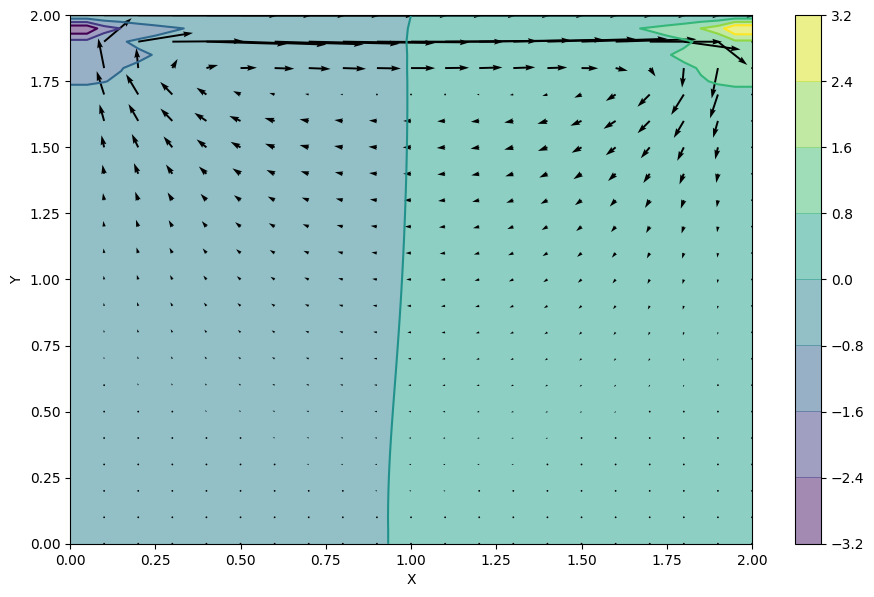

In [7]:
fig = plt.figure(figsize=(11,7), dpi=100)
plt.contourf(X,Y,p,alpha= 0.5, cmap=cm.viridis)
plt.colorbar()
plt.contour(X,Y,p, cmap=cm.viridis)
skip = 2
plt.quiver(X[::skip, ::skip], Y[::skip, ::skip], u[::skip, ::skip], v[::skip, ::skip])
plt.xlabel('X')
plt.ylabel('Y');

We can see how the two distinct pressure zones are forming and the spiral pattern expected from the lid cavity is beginning to form. Let's look at different nt times and see how long the system takes to stabilize.

In [8]:
u = np.zeros((ny, nx))
v = np.zeros((ny, nx))
p = np.zeros((ny, nx))
b = np.zeros((ny, nx))
nt = 1000
u, v, p = cavity_flow(nt, u, v, dt, dx, dy, p, rho, nu)

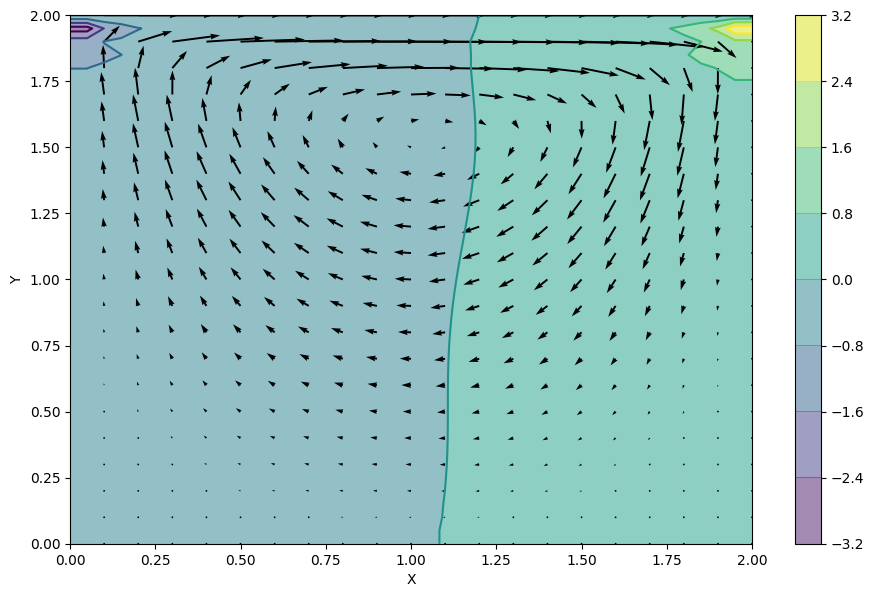

In [9]:
fig = plt.figure(figsize=(11,7), dpi=100)
plt.contourf(X,Y,p,alpha= 0.5, cmap=cm.viridis)
plt.colorbar()
plt.contour(X,Y,p, cmap=cm.viridis)
skip = 2
plt.quiver(X[::skip, ::skip], Y[::skip, ::skip], u[::skip, ::skip], v[::skip, ::skip])
plt.xlabel('X')
plt.ylabel('Y');

### Results

The spiral  pattern expected from lid-driven cavity flow is showing and the different entrance and exit pressures are very distincte too. Pretty cool right?! Let's try to animate it, which I am not sure will work but it's worth a try.

## Animating the simulation

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1173: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/quiver.py:666: RuntimeWarning: divide by zero encountered in double_scalars
  length = a * (widthu_per_lenu / (self.scale * self.width))
/usr/local/lib/python3.6/dist-packages/matplotlib/quiver.py:666: RuntimeWarning: invalid value encountered in multiply
  length = a * (widthu_per_lenu / (self.scale * self.width))
/usr/local/lib/python3.6/dist-packages/matplotlib/quiver.py:719: RuntimeWarning: invalid value encountered in less
  short = np.repeat(length < minsh, 8, axis=1)
/usr/local/lib/python3.6/dist-packages/matplotlib/quiver.py:733: RuntimeWarning: invalid value encountered in less
  tooshort = length < self.minlength


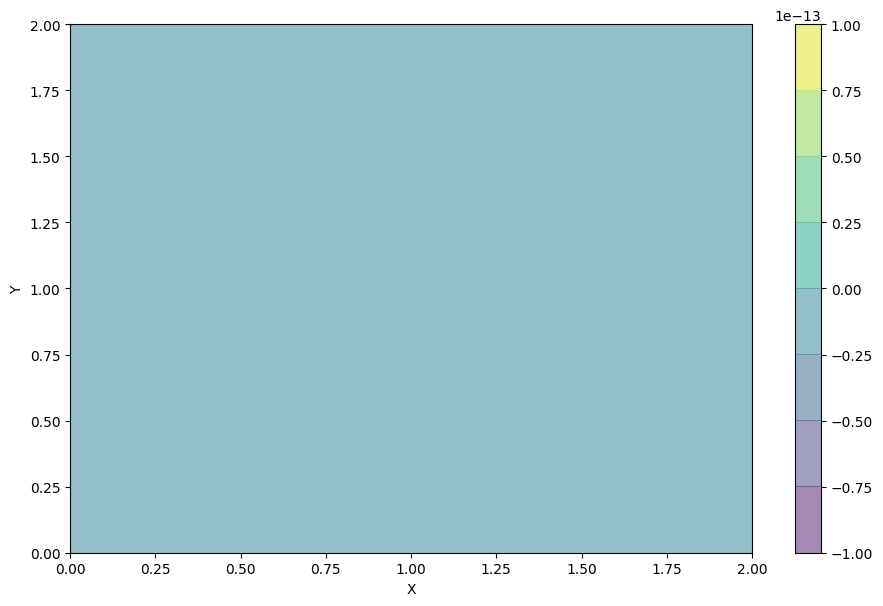

In [10]:
#Imports for animation and display within a jupyter notebook
from matplotlib import animation, rc 
from IPython.display import HTML

#Resetting back to initial conditions
u = np.zeros((ny, nx))
v = np.zeros((ny, nx))
p = np.zeros((ny, nx))
b = np.zeros((ny, nx))
nt = 250
nt2 = 100

#Generating the figure that will contain the animation
fig, ax = plt.subplots()
fig.set_dpi(100)
fig.set_size_inches(11,7)
plt.contourf(X,Y,p,alpha= 0.5, cmap=cm.viridis)
plt.colorbar()
plt.contour(X,Y,p, cmap=cm.viridis)
skip = 2
plt.quiver(X[::skip, ::skip], Y[::skip, ::skip], u[::skip, ::skip], v[::skip, ::skip])
plt.xlabel('X')
plt.ylabel('Y');

In [11]:
#Initialization function for funcanimation
def init():
    ax.clear()
    cf = ax.contourf(X,Y,p,alpha= 0.5, cmap=cm.viridis)
    cc = ax.contour(X,Y,p, cmap=cm.viridis)
    cq = ax.quiver(X[::skip, ::skip], Y[::skip, ::skip], u[::skip, ::skip], v[::skip, ::skip])
    return cf,cc,cq

In [12]:
#Main animation function, each frame represents a time step in our calculation
def animate(j):
    global b , p, u ,v
    un = u.copy()
    vn = v.copy()
    for n in range(nt2):
        b = build_up_b(b, rho, dt, u, v, dx, dy)
        p = pressure_poisson(p, dx, dy, b)

        u[1:-1, 1:-1] = (un[1:-1, 1:-1]-
                         un[1:-1, 1:-1] * dt / dx *
                        (un[1:-1, 1:-1] - un[1:-1, 0:-2]) -
                         vn[1:-1, 1:-1] * dt / dy *
                        (un[1:-1, 1:-1] - un[0:-2, 1:-1]) -
                         dt / (2 * rho * dx) * (p[1:-1, 2:] - p[1:-1, 0:-2]) +
                         nu * (dt / dx**2 *
                        (un[1:-1, 2:] - 2 * un[1:-1, 1:-1] + un[1:-1, 0:-2]) +
                         dt / dy**2 *
                        (un[2:, 1:-1] - 2 * un[1:-1, 1:-1] + un[0:-2, 1:-1])))

        v[1:-1,1:-1] = (vn[1:-1, 1:-1] -
                        un[1:-1, 1:-1] * dt / dx *
                       (vn[1:-1, 1:-1] - vn[1:-1, 0:-2]) -
                        vn[1:-1, 1:-1] * dt / dy *
                       (vn[1:-1, 1:-1] - vn[0:-2, 1:-1]) -
                        dt / (2 * rho * dy) * (p[2:, 1:-1] - p[0:-2, 1:-1]) +
                        nu * (dt / dx**2 *
                       (vn[1:-1, 2:] - 2 * vn[1:-1, 1:-1] + vn[1:-1, 0:-2]) +
                        dt / dy**2 *
                       (vn[2:, 1:-1] - 2 * vn[1:-1, 1:-1] + vn[0:-2, 1:-1])))

        u[0, :]  = 0
        u[:, 0]  = 0
        u[:, -1] = 0
        u[-1, :] = 1   #set velocity on cavity lid equal to 1
        v[0, :]  = 0
        v[-1, :] = 0
        v[:, 0]  = 0
        v[:, -1] = 0
    
    ax.clear()
    cf =ax.contourf(X,Y,p,alpha= 0.5, cmap=cm.viridis)
    cc = ax.contour(X,Y,p, cmap=cm.viridis)
    cq = ax.quiver(X[::skip, ::skip], Y[::skip, ::skip], u[::skip, ::skip], v[::skip, ::skip]);
    return cf,cc,cq

In [13]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=nt, interval=20)
HTML(anim.to_jshtml())

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1173: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
Animation size has reached 21040898 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


## Conclusion

Our first cavity lid flow sim looks great! The animation shows the spiral pattern and the growth of the two distinct pressure fields at the corners. We'll now move forward to adapting this code to a different set